In [1]:
import os
import re  # Asegúrate de importar re para la expresión regular
import torch
from torch_geometric.utils import to_dense_adj  
from torch_geometric.loader import DataLoader
from torch_geometric.data import Data
import gc 
def orden_numerico(archivo):
    # Extraer el número del nombre del archivo utilizando una expresión regular
    numero = re.search(r'\d+', archivo)
    if numero:
        return int(numero.group())
    return 0

ruta_guardado = "SnapshotsT/"

if not os.path.exists(ruta_guardado):
    raise RuntimeError(f"La ruta especificada no existe: {ruta_guardado}")

snapshots_reestructurados = []
num_archivos_intentados = 0
num_archivos_cargados = 0

# Lista de archivos .pt en la ruta especificada
archivos = [archivo for archivo in os.listdir(ruta_guardado) if archivo.endswith('.pt')]

# Ordenar los archivos por orden numérico
archivos_ordenados = sorted(archivos, key=orden_numerico)

for archivo in archivos_ordenados:
    num_archivos_intentados += 1
    ruta_archivo = os.path.join(ruta_guardado, archivo)
    try:
        snapshot = torch.load(ruta_archivo)
        print(f"cargando el archivo {archivo}")
        # Aquí puedes agregar comprobaciones adicionales sobre el contenido de 'snapshot'
        snapshots_reestructurados.append(snapshot)
        del snapshot
        gc.collect()
        
        
        num_archivos_cargados += 1
    except Exception as e:
        print(f"Error al cargar el archivo {archivo}: {e}")

print(f"{num_archivos_cargados} de {num_archivos_intentados} archivos han sido cargados correctamente.")

# Verificar consistencia en las dimensiones de 'x'
x_dims = [snapshot.x.size() for snapshot in snapshots_reestructurados if hasattr(snapshot, 'x')]
# Verifica si todos los elementos en x_dims son iguales
consistent_x_dims = all(x == x_dims[0] for x in x_dims)

# Verificar consistencia en las dimensiones de 'y'
y_dims = [snapshot.y.size() for snapshot in snapshots_reestructurados if hasattr(snapshot, 'y')]
# Verifica si todos los elementos en y_dims son iguales
consistent_y_dims = all(y == y_dims[0] for y in y_dims)

print(f"Todas las dimensiones de 'x' son consistentes: {consistent_x_dims}")
print(f"Todas las dimensiones de 'y' son consistentes: {consistent_y_dims}")
snapshots_reestructurados[0]

cargando el archivo snapshot_6.pt
cargando el archivo snapshot_7.pt
cargando el archivo snapshot_8.pt
cargando el archivo snapshot_9.pt
cargando el archivo snapshot_10.pt
cargando el archivo snapshot_11.pt
cargando el archivo snapshot_12.pt
cargando el archivo snapshot_13.pt
cargando el archivo snapshot_14.pt
cargando el archivo snapshot_15.pt
cargando el archivo snapshot_16.pt
cargando el archivo snapshot_17.pt
cargando el archivo snapshot_18.pt
cargando el archivo snapshot_19.pt
cargando el archivo snapshot_20.pt
cargando el archivo snapshot_21.pt
cargando el archivo snapshot_22.pt
cargando el archivo snapshot_23.pt
cargando el archivo snapshot_24.pt
cargando el archivo snapshot_25.pt
cargando el archivo snapshot_26.pt
cargando el archivo snapshot_27.pt
cargando el archivo snapshot_28.pt
cargando el archivo snapshot_29.pt
cargando el archivo snapshot_30.pt
cargando el archivo snapshot_31.pt
cargando el archivo snapshot_32.pt
cargando el archivo snapshot_33.pt
cargando el archivo snap

Data(x=[31, 7, 12], edge_index=[2, 293], edge_attr=[293, 1], y=[31, 14], coordinates=[31, 2])

In [2]:
import torch
from torch_geometric.data import Data
from torch_geometric.loader import DataLoader    
from torch_geometric.utils import to_dense_adj   

# Asumiendo que 'snapshots_reestructurados' es tu lista de datos
total_datos = len(snapshots_reestructurados)
train_size = int(0.7 * total_datos)
val_size = int(0.15 * total_datos)
test_size = total_datos - train_size - val_size

# Dividir los datos basándose en el orden cronológico
train_dataset = snapshots_reestructurados[:train_size]
val_dataset = snapshots_reestructurados[train_size:train_size + val_size]
test_dataset = snapshots_reestructurados[train_size + val_size:]


# Establece un umbral mínimo para la desviación estándar
umbral_std = 1e-6

# Supongamos que cada elemento de train_dataset tiene un atributo .x que es un tensor
# Concatenamos todos los datos x para calcular la media y desviación estándar
all_train_data = torch.cat([data.x for data in train_dataset])

# Calcular la media y la desviación estándar del conjunto de entrenamiento
mean = torch.mean(all_train_data, axis=0)
std = torch.std(all_train_data, axis=0)
std[std < umbral_std] = 1

# Función para normalizar un dataset
def normalize_dataset(dataset, mean, std):
    for data in dataset:
        data.x = ((data.x.to(torch.float64) - mean) / std).to(torch.float32)  # Conversión a float32 para el entrenamiento
    return dataset

# Normaliza los conjuntos de datos utilizando los parámetros del conjunto de entrenamiento
train_dataset = normalize_dataset(train_dataset, mean, std)
val_dataset = normalize_dataset(val_dataset, mean, std)
test_dataset = normalize_dataset(test_dataset, mean, std)

print(len(train_dataset))
print(len(val_dataset))
print(len(test_dataset))

adj_matrix = to_dense_adj(snapshots_reestructurados[0].edge_index)

batch_size = 1  # Ajusta esto según las necesidades de tu modelo y hardware

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=False)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

for batch in train_loader:
    print("Tamaño del lote (número de grafos):", batch.num_graphs)
    print("Características del primer grafo del lote:", batch[0].x.shape)
    print("Etiquetas del primer grafo del lote:", batch[0].y.shape)
    # Interrumpir después de la primera iteración para no imprimir todos los lotes
    break

4403
943
944
Tamaño del lote (número de grafos): 1
Características del primer grafo del lote: torch.Size([31, 7, 12])
Etiquetas del primer grafo del lote: torch.Size([31, 14])


In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch_geometric.nn import TransformerConv

class SimplifiedSpatioTemporalGCN(nn.Module):
    def __init__(self, in_features, hidden_channels, out_features, num_timesteps, dropout_rate=0.3):
        super(SimplifiedSpatioTemporalGCN, self).__init__()
        
        # Capas convolucionales 1D para procesar la dimensión temporal
        self.conv1d_1 = nn.Conv1d(in_channels=in_features, out_channels=16, kernel_size=3, padding=1)
        self.conv1d_2 = nn.Conv1d(in_channels=16, out_channels=32, kernel_size=3, padding=1)
        
        # LSTM para capturar dependencias temporales
        self.lstm = nn.LSTM(input_size=32, hidden_size=hidden_channels, batch_first=True)
        
        # Capa TransformerConv para procesar las características espaciales
        self.transconv = TransformerConv(hidden_channels, hidden_channels, heads=2, concat=False)
        
        # Dropout
        self.dropout = nn.Dropout(p=dropout_rate)
        
        # Capa lineal para generar la salida final
        self.fc = nn.Linear(hidden_channels, out_features)

    def forward(self, x, edge_index):
        # x tiene forma [num_nodos, num_tiempos, num_características]
        
        # Reorganizar para convoluciones 1D: [num_nodos, num_características, num_tiempos]
        x = x.permute(0, 2, 1)  # [num_nodos, num_features, num_timesteps]
        
        # Aplicar convoluciones 1D
        x = F.relu(self.conv1d_1(x))  # Salida: [num_nodos, 16, num_timesteps]
        x = F.relu(self.conv1d_2(x))  # Salida: [num_nodos, 32, num_timesteps]
        
        # Reorganizar para LSTM: [num_nodos, num_timesteps, 32]
        x = x.permute(0, 2, 1)
        
        # Aplicar LSTM: [num_nodos, num_tiempos, hidden_channels]
        x, _ = self.lstm(x)
        
        # Tomar la última salida de LSTM para cada nodo: [num_nodos, hidden_channels]
        x = x[:, -1, :]
        
        # Aplicar la capa TransformerConv
        x = self.transconv(x, edge_index)
        x = F.relu(x)
        x = self.dropout(x)  # Aplicar Dropout
        
        # Capa lineal para obtener la salida final: [num_nodos, out_features]
        x = self.fc(x)
        return x

# Parámetros del modelo
num_nodes = 31
num_timesteps = 7
num_features = 12
hidden_channels = 64
output_features = 14
dropout_rate = 0.4

# Instanciar el modelo
model = SimplifiedSpatioTemporalGCN(
    in_features=num_features,
    hidden_channels=hidden_channels,
    out_features=output_features,
    num_timesteps=num_timesteps,
    dropout_rate=dropout_rate
)


In [4]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch_geometric.data import Data
from torch.optim.lr_scheduler import ReduceLROnPlateau
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
#device = torch.device( 'cpu')
print(f"Usando dispositivo: {device}")
# Define el criterio de pérdida y el optimizador
criterion = nn.HuberLoss()
#criterion = nn.L1Loss()

optimizer = optim.AdamW(model.parameters(), lr=0.001)

# Usa ReduceLROnPlateau para ajustar la tasa de aprendizaje
#scheduler = ReduceLROnPlateau(optimizer, 'min', factor=0.5, patience=5, verbose=True)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5, verbose=True)


# Mover el modelo al dispositivo (GPU si está disponible, sino CPU)
model.to(device)


def train(model, train_loader):
    model.train()
    total_loss = 0
  

    for data in train_loader:
    
        torch.autograd.set_detect_anomaly(True)
        # Mover los datos al dispositivo
        data = data.to(device)
        
        optimizer.zero_grad()
        out = model(data.x, data.edge_index)
        loss = criterion(out, data.y)

        loss.backward(retain_graph=True)  # Usar en la primera llam

        optimizer.step()
        total_loss += loss.item()
    return total_loss / len(train_loader)
  
# Función de validación modificada para usar GPU
def validate(model, val_loader):
    model.eval()
    total_loss = 0
    with torch.no_grad():
        for data in val_loader:
            # Mover los datos al dispositivo
            data = data.to(device)
            
            out = model(data.x, data.edge_index)
            loss = criterion(out, data.y)
            total_loss += loss.item()
    return total_loss / len(val_loader)

# Entrenamiento y validación
num_epochs = 100
best_val_loss = float('inf')
best_model = None

for epoch in range(num_epochs):
    train_loss = train(model, train_loader)
    val_loss = validate(model, val_loader)
    print(f'Epoch: {epoch+1}, Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}')
    
    # Actualiza el scheduler con la pérdida de validación
    scheduler.step(val_loss)

    # Guardar el modelo si la pérdida de validación mejora
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        best_model = model.state_dict()
        # Opcional: Guarda el modelo en el disco
        torch.save(model.state_dict(), 'best_model.pth')

# Cargar el mejor modelo
model.load_state_dict(torch.load('best_model.pth'))


Usando dispositivo: cuda


c:\Users\marcs\miniconda3\Lib\site-packages\torch\optim\lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Epoch: 1, Train Loss: 0.0015, Validation Loss: 0.0006
Epoch: 2, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 3, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 4, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 5, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 6, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 7, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 8, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 9, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 10, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 11, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 12, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 13, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 14, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 15, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 16, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 17, Train Loss: 0.0006, Validation Loss: 0.0005
Epoch: 18, Train Loss: 0.0005, Validation Loss: 0.0005
Epoch: 19, Train Lo

<All keys matched successfully>

In [11]:
import numpy as np
import torch
import matplotlib.pyplot as plt

# Cargar el modelo

#model.load_state_dict(torch.load('best_model.pth'))
nombres_compuestos = ['LAeq']  # Puedes agregar más compuestos aquí


# Función para calcular métricas
def calculate_metrics(outputs, targets):
    mse = criterion(outputs, targets)
    rmse = torch.sqrt(mse)
    mae = torch.mean(torch.abs(outputs - targets))
    mape = torch.mean(torch.abs((targets - outputs) / torch.clamp(targets, min=1e-8))) * 100

    outputs_np = outputs.detach().cpu().numpy()
    targets_np = targets.detach().cpu().numpy()

    ss_res = np.sum((targets_np - outputs_np) ** 2)
    ss_tot = np.sum((targets_np - np.mean(targets_np)) ** 2)
    r_squared = 1 - (ss_res / ss_tot) if ss_tot != 0 else np.nan

    if np.std(outputs_np) > 0 and np.std(targets_np) > 0:
        correlation = np.corrcoef(outputs_np.ravel(), targets_np.ravel())[0, 1]
    else:
        correlation = np.nan

    tolerance = 0.1 * np.mean(targets_np)
    accuracy = np.mean(np.abs(outputs_np - targets_np) < tolerance)

    return mse.item(), rmse.item(), mae.item(), mape.item(), r_squared, correlation, accuracy

# Función de prueba
def test(model, test_loader, num_compounds, num_steps, nombres_compuestos):
    model.eval()
    device = next(model.parameters()).device
    metrics_per_step_compound = [[[] for _ in range(num_steps)] for _ in range(num_compounds)]

    with torch.no_grad():
        for data in test_loader:
            data = data.to(device)
            out = model(data.x, data.edge_index)
            out = out.view(-1, num_compounds, num_steps).to(device)
            y = data.y.view(-1, num_compounds, num_steps).to(device)

            for j in range(num_compounds):
                for i in range(num_steps):
                    metrics = calculate_metrics(out[:, j, i], y[:, j, i])
                    metrics_per_step_compound[j][i].append(metrics)

    # Promediar las métricas para cada paso de tiempo y cada compuesto
    averaged_metrics = [[np.mean(metrics, axis=0) for metrics in step_compounds] for step_compounds in metrics_per_step_compound]
    return averaged_metrics

# Ejemplo de uso
num_compounds = 1  # Número de compuestos
num_steps = 14      # Número de pasos de tiempo
averaged_metrics = test(model, test_loader, num_compounds, num_steps, nombres_compuestos)

# Calcular y mostrar las medias por compuesto
medias_por_compuesto = []
for j in range(num_compounds):
    metrics_compound = [averaged_metrics[j][i] for i in range(num_steps)]
    metrics_array = np.array(metrics_compound)
    mean_metrics = np.mean(metrics_array, axis=0)
    medias_por_compuesto.append(mean_metrics)

# Imprimir las medias de las métricas para cada compuesto
for i, mean_metrics in enumerate(medias_por_compuesto):
    mse, rmse, mae, mape, r_squared, corr, accuracy = mean_metrics
    print(f"Media para {nombres_compuestos[i]} - MSE: {mse:.4f}, RMSE: {rmse:.4f}, MAE: {mae:.4f}, MAPE: {mape:.4f}, R^2: {r_squared:.4f}, Correlación: {corr:.4f}, Precisión: {accuracy:.4f}") 

Media para LAeq - MSE: 0.0005, RMSE: 0.0201, MAE: 0.0211, MAPE: 6.1299, R^2: 0.8424, Correlación: 0.9429, Precisión: 0.8480


In [6]:
import numpy as np
import torch

# Función para calcular métricas
def calculate_metrics(outputs, targets):
    mse = criterion(outputs, targets)
    rmse = torch.sqrt(mse)
    mae = torch.mean(torch.abs(outputs - targets))
    mape = torch.mean(torch.abs((targets - outputs) / torch.clamp(targets, min=1e-8))) * 100

    outputs_np = outputs.detach().cpu().numpy()
    targets_np = targets.detach().cpu().numpy()

    ss_res = np.sum((targets_np - outputs_np) ** 2)
    ss_tot = np.sum((targets_np - np.mean(targets_np)) ** 2)
    r_squared = 1 - (ss_res / ss_tot) if ss_tot != 0 else np.nan

    if np.std(outputs_np) > 0 and np.std(targets_np) > 0:
        correlation = np.corrcoef(outputs_np.ravel(), targets_np.ravel())[0, 1]
    else:
        correlation = np.nan

    tolerance = 0.1 * np.mean(targets_np)
    accuracy = np.mean(np.abs(outputs_np - targets_np) < tolerance)

    return mse.item(), rmse.item(), mae.item(), mape.item(), r_squared, correlation, accuracy

# Función de prueba
def test(model, test_loader, num_compounds, num_steps, nombres_compuestos):
    model.eval()
    device = next(model.parameters()).device
    metrics_per_step_compound = [[[] for _ in range(num_steps)] for _ in range(num_compounds)]

    with torch.no_grad():
        for data in test_loader:
            data = data.to(device)
            out = model(data.x, data.edge_index)
            out = out.view(-1, num_compounds, num_steps).to(device)
            y = data.y.view(-1, num_compounds, num_steps).to(device)

            for j in range(num_compounds):
                for i in range(num_steps):
                    metrics = calculate_metrics(out[:, j, i], y[:, j, i])
                    metrics_per_step_compound[j][i].append(metrics)

    # Promediar las métricas para cada paso de tiempo y cada compuesto
    averaged_metrics = [[np.mean(metrics, axis=0) for metrics in step_compounds] for step_compounds in metrics_per_step_compound]
    return averaged_metrics

# Ejemplo de uso
num_compounds = 1  # Número de compuestos
num_steps = 14      # Número de pasos de tiempo
averaged_metrics = test(model, test_loader, num_compounds, num_steps, nombres_compuestos)

# Calcular y mostrar las métricas por paso de tiempo
for j in range(num_compounds):
    print(f"\nMétricas para {nombres_compuestos[j]}:")
    for i in range(num_steps):
        mse, rmse, mae, mape, r_squared, corr, accuracy = averaged_metrics[j][i]
        print(f"Paso de tiempo {i + 1}: MSE: {mse:.4f}, RMSE: {rmse:.4f}, MAE: {mae:.4f}, MAPE: {mape:.4f}, R^2: {r_squared:.4f}, Correlación: {corr:.4f}, Precisión: {accuracy:.4f}")



Métricas para LAeq:
Paso de tiempo 1: MSE: 0.0004, RMSE: 0.0194, MAE: 0.0202, MAPE: 5.8936, R^2: 0.8538, Correlación: 0.9462, Precisión: 0.8601
Paso de tiempo 2: MSE: 0.0004, RMSE: 0.0196, MAE: 0.0205, MAPE: 5.9803, R^2: 0.8503, Correlación: 0.9464, Precisión: 0.8551
Paso de tiempo 3: MSE: 0.0005, RMSE: 0.0203, MAE: 0.0213, MAPE: 6.2007, R^2: 0.8400, Correlación: 0.9429, Precisión: 0.8435
Paso de tiempo 4: MSE: 0.0005, RMSE: 0.0200, MAE: 0.0209, MAPE: 6.0879, R^2: 0.8446, Correlación: 0.9434, Precisión: 0.8492
Paso de tiempo 5: MSE: 0.0005, RMSE: 0.0206, MAE: 0.0216, MAPE: 6.2990, R^2: 0.8362, Correlación: 0.9412, Precisión: 0.8365
Paso de tiempo 6: MSE: 0.0005, RMSE: 0.0205, MAE: 0.0215, MAPE: 6.2470, R^2: 0.8375, Correlación: 0.9423, Precisión: 0.8401
Paso de tiempo 7: MSE: 0.0005, RMSE: 0.0206, MAE: 0.0217, MAPE: 6.3005, R^2: 0.8345, Correlación: 0.9407, Precisión: 0.8384
Paso de tiempo 8: MSE: 0.0005, RMSE: 0.0200, MAE: 0.0209, MAPE: 6.0881, R^2: 0.8431, Correlación: 0.9428, Preci

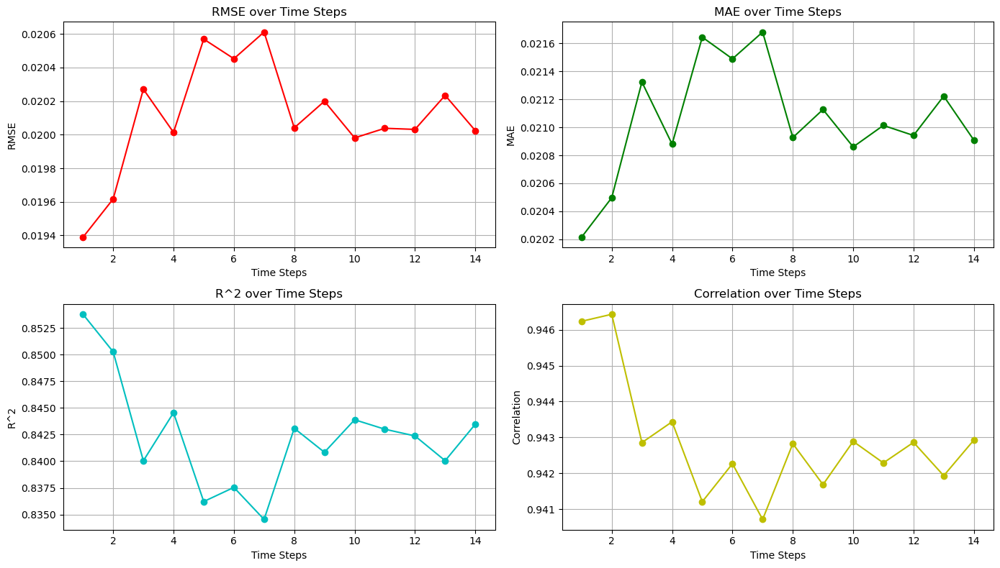

In [7]:
import matplotlib.pyplot as plt
import numpy as np
import torch

# Assuming 'averaged_metrics' has been computed using the provided code

# Extract metrics for plotting
num_steps = 14  # Number of time steps
rmse_list = []
mae_list = []
r_squared_list = []
correlation_list = []
accuracy_list = []

# Assuming there's only one compound in this example
for i in range(num_steps):
    mse, rmse, mae, mape, r_squared, corr, accuracy = averaged_metrics[0][i]
    rmse_list.append(rmse)
    mae_list.append(mae)
    r_squared_list.append(r_squared)
    correlation_list.append(corr)
    accuracy_list.append(accuracy)

# Create line plots for the selected metrics
time_steps = np.arange(1, num_steps + 1)

plt.figure(figsize=(14, 8))

# Plot RMSE
plt.subplot(2, 2, 1)
plt.plot(time_steps, rmse_list, marker='o', linestyle='-', color='r', label='RMSE')
plt.xlabel('Time Steps')
plt.ylabel('RMSE')
plt.title('RMSE over Time Steps')
plt.grid(True)

# Plot MAE
plt.subplot(2, 2, 2)
plt.plot(time_steps, mae_list, marker='o', linestyle='-', color='g', label='MAE')
plt.xlabel('Time Steps')
plt.ylabel('MAE')
plt.title('MAE over Time Steps')
plt.grid(True)

# Plot R^2
plt.subplot(2, 2, 3)
plt.plot(time_steps, r_squared_list, marker='o', linestyle='-', color='c', label='R^2')
plt.xlabel('Time Steps')
plt.ylabel('R^2')
plt.title('R^2 over Time Steps')
plt.grid(True)

# Plot Correlation
plt.subplot(2, 2, 4)
plt.plot(time_steps, correlation_list, marker='o', linestyle='-', color='y', label='Correlation')
plt.xlabel('Time Steps')
plt.ylabel('Correlation')
plt.title('Correlation over Time Steps')
plt.grid(True)

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


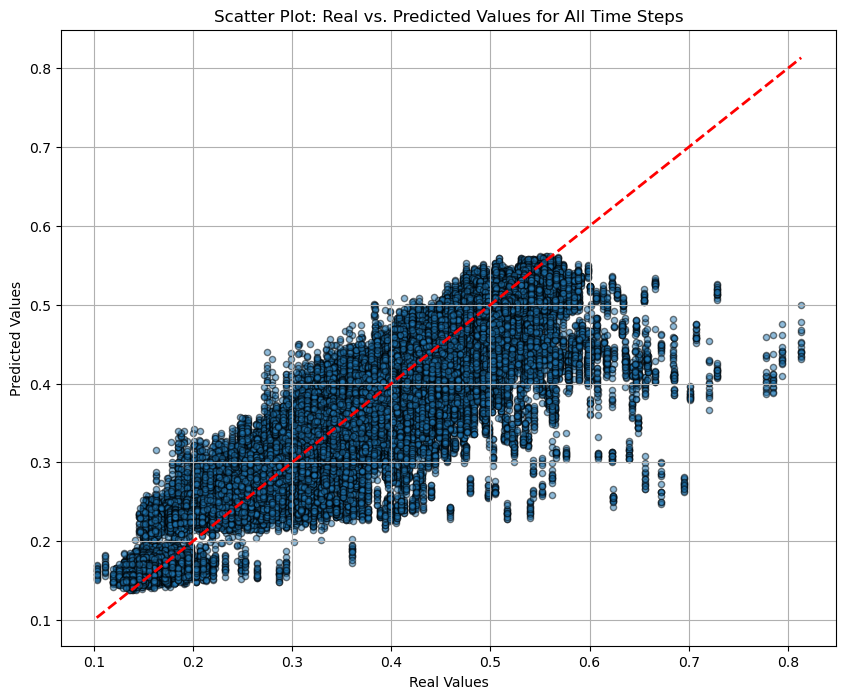

In [8]:
import numpy as np
import torch
import matplotlib.pyplot as plt

# Asumiendo que ya has cargado tu modelo y los datos
# model.load_state_dict(torch.load('best_model.pth'))
nombres_compuestos = ['LAeq']  # Puedes agregar más compuestos aquí
# Función para hacer predicciones con incertidumbre utilizando Dropout
def predict_with_uncertainty(model, data, num_samples=100):
    model.train()  # Asegúrate de que el Dropout esté activado
    outputs_list = []
    
    with torch.no_grad():
        for _ in range(num_samples):
            outputs = model(data.x, data.edge_index)
            outputs_list.append(outputs.cpu().numpy())

    # Calcular la media y desviación estándar de las predicciones
    outputs_mean = np.mean(outputs_list, axis=0)
    outputs_std = np.std(outputs_list, axis=0)
    
    return outputs_mean, outputs_std
# Función de prueba para obtener valores reales y predichos
def get_real_and_predicted(model, test_loader, num_compounds, num_steps):
    model.eval()
    device = next(model.parameters()).device

    real_values = []
    predicted_values = []

    with torch.no_grad():
        for data in test_loader:
            data = data.to(device)
            out_mean, _ = predict_with_uncertainty(model, data)  # Obtener las predicciones
            out_mean = torch.tensor(out_mean).view(-1, num_compounds, num_steps).to(device)
            y = data.y.view(-1, num_compounds, num_steps).to(device)

            # Extraer los valores reales y predichos
            real_values.append(y.cpu().numpy())
            predicted_values.append(out_mean.cpu().numpy())
    
    # Convertir listas a arrays de NumPy
    real_values = np.concatenate(real_values, axis=0)
    predicted_values = np.concatenate(predicted_values, axis=0)
    
    return real_values, predicted_values

# Ejemplo de uso
num_compounds = 1  # Número de compuestos
num_steps = 14      # Número de pasos de tiempo
real_values, predicted_values = get_real_and_predicted(model, test_loader, num_compounds, num_steps)

# Select real and predicted values for all time steps
real_values_flat = real_values[:, 0, :].ravel()  # Flatten to include all nodes and time steps
predicted_values_flat = predicted_values[:, 0, :].ravel()  # Flatten to include all predictions

# Create the scatter plot
plt.figure(figsize=(10, 8))
plt.scatter(real_values_flat, predicted_values_flat, alpha=0.5, edgecolors='k', s=20)
plt.plot([real_values_flat.min(), real_values_flat.max()], [real_values_flat.min(), real_values_flat.max()], 'r--', lw=2)
plt.xlabel('Real Values')
plt.ylabel('Predicted Values')
plt.title('Scatter Plot: Real vs. Predicted Values for All Time Steps')
plt.grid(True)
plt.show()



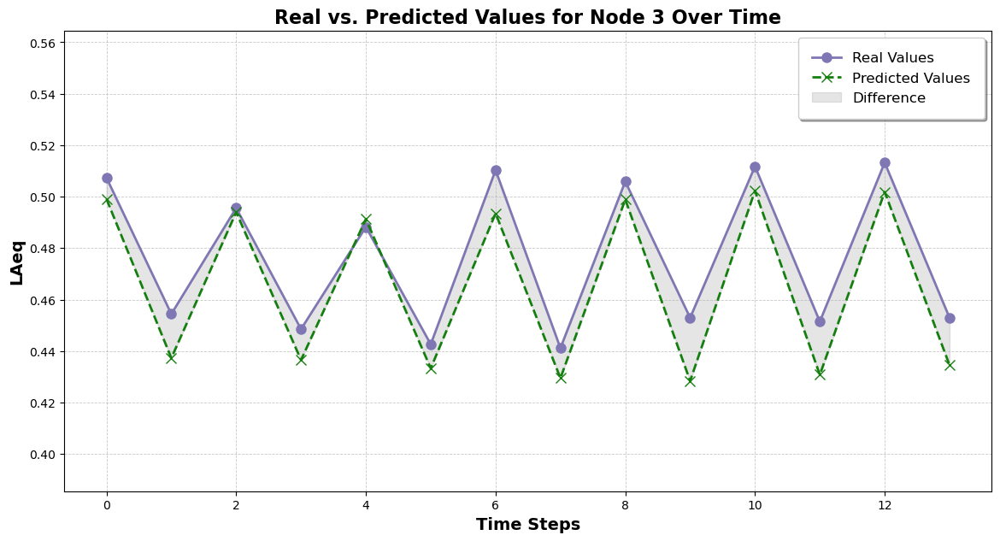

In [9]:
# Import necessary libraries
import matplotlib.pyplot as plt
import numpy as np

# Select a node and plot the values over the time steps
node_index = 3  # Index of the node to visualize
time_steps = np.arange(num_steps)

# Extract the real and predicted values for the selected node
real_values_node = real_values[node_index, 0, :]
predicted_values_node = predicted_values[node_index, 0, :]

# Create the enhanced line plot
plt.figure(figsize=(14, 7))
plt.plot(time_steps, real_values_node, marker='o', linestyle='-', color='#7f77b4', linewidth=2, markersize=8, label='Real Values')
plt.plot(time_steps, predicted_values_node, marker='x', linestyle='--', color='#137f0e', linewidth=2, markersize=8, label='Predicted Values')

# Add a shaded area to indicate the error
plt.fill_between(time_steps, real_values_node, predicted_values_node, color='gray', alpha=0.2, label='Difference')

# Set labels and title with a clearer style
plt.xlabel('Time Steps', fontsize=14, fontweight='bold')
plt.ylabel(f'{nombres_compuestos[0]}', fontsize=14, fontweight='bold')
plt.title(f'Real vs. Predicted Values for Node {node_index} Over Time', fontsize=16, fontweight='bold')

# Improve the legend
plt.legend(loc='upper right', fontsize=12, frameon=True, shadow=True, borderpad=1)

# Customize the grid
plt.grid(True, linestyle='--', linewidth=0.6, alpha=0.7)

# Adjust y-axis limits for better visibility
plt.ylim([min(real_values_node.min(), predicted_values_node.min()) * 0.9, max(real_values_node.max(), predicted_values_node.max()) * 1.1])

# Show the plot
plt.show()


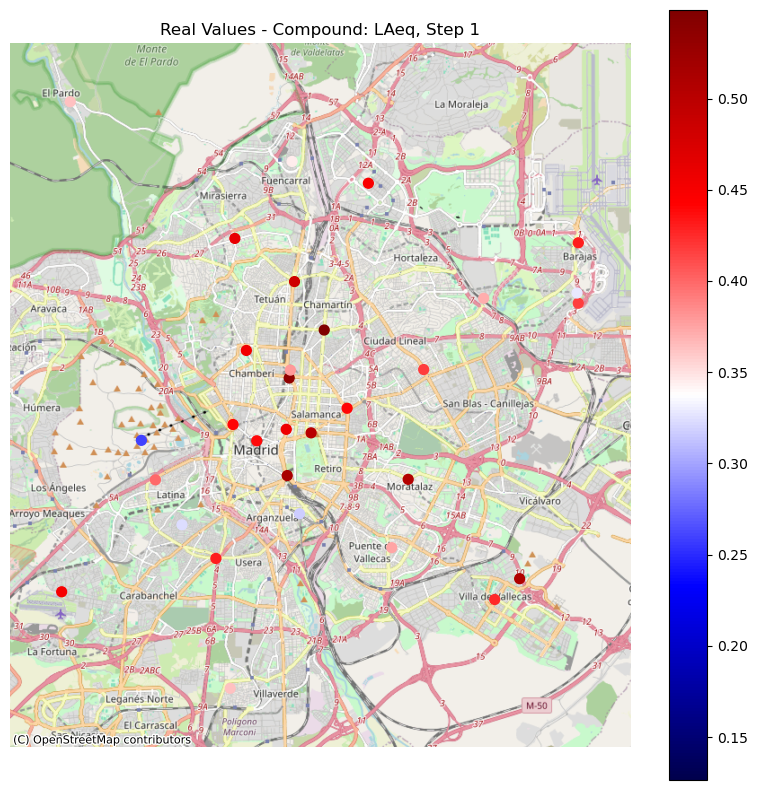

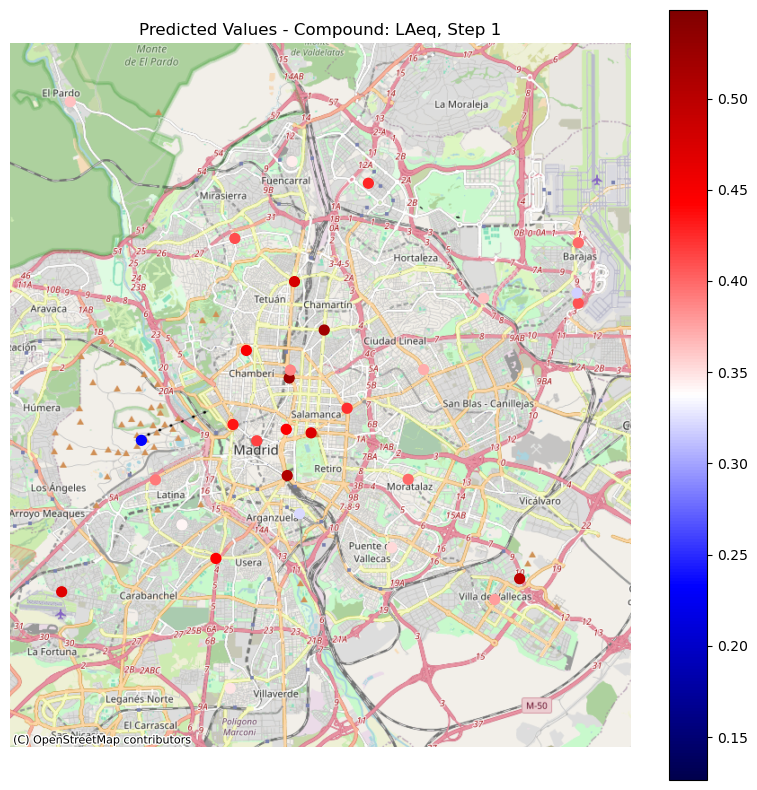

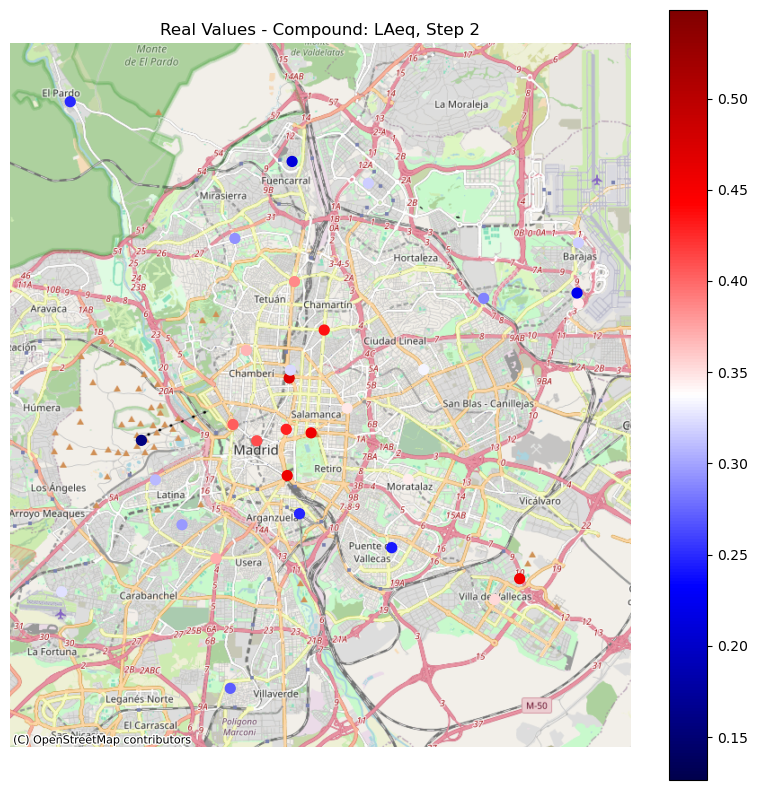

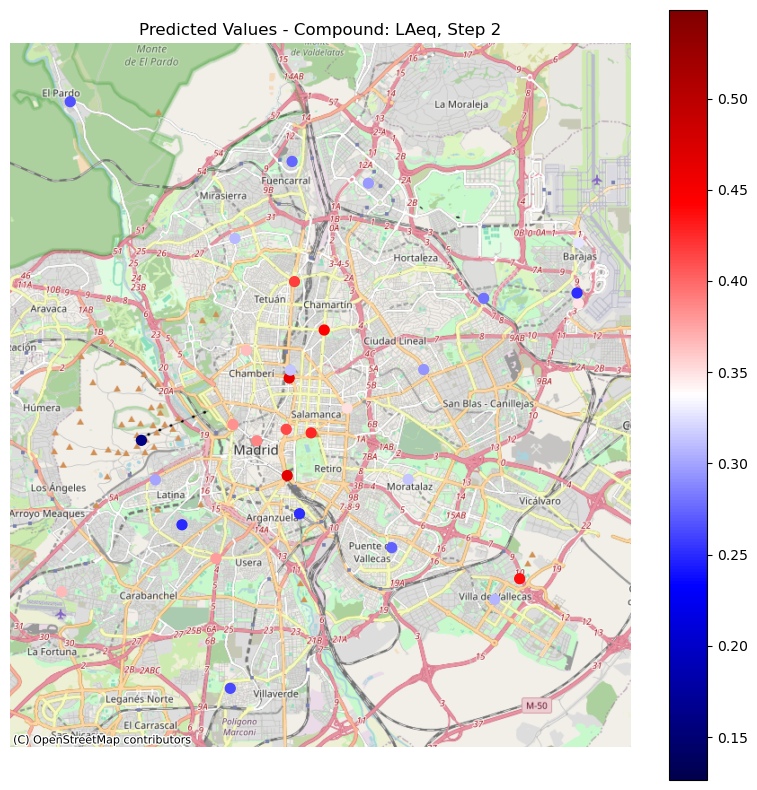

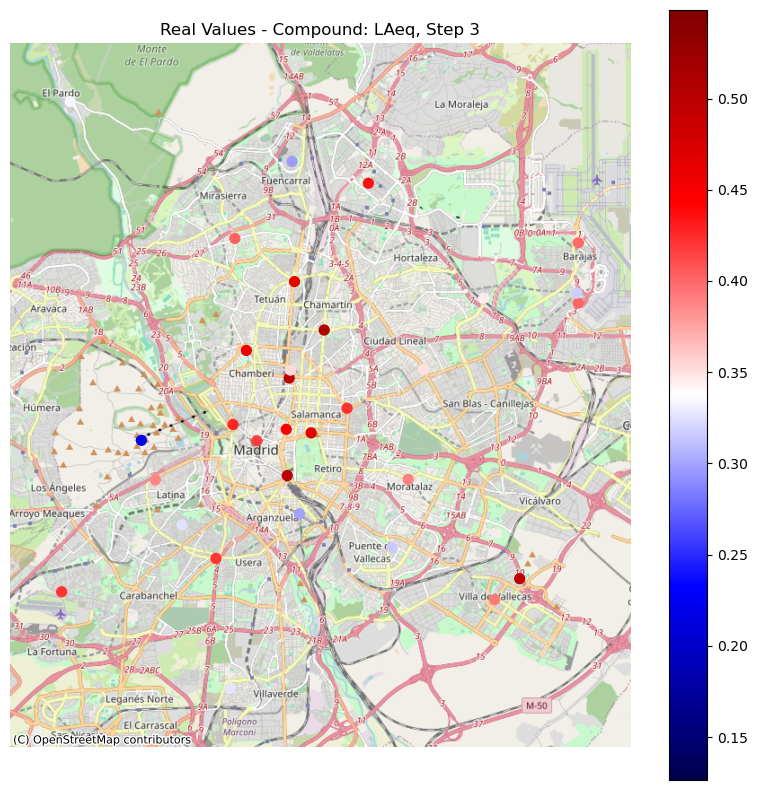

...

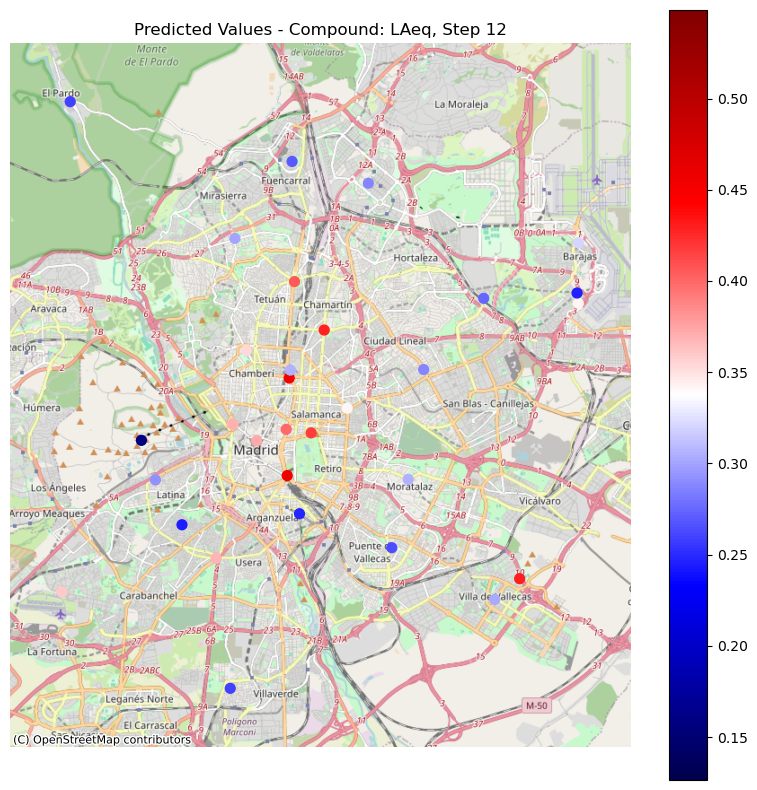

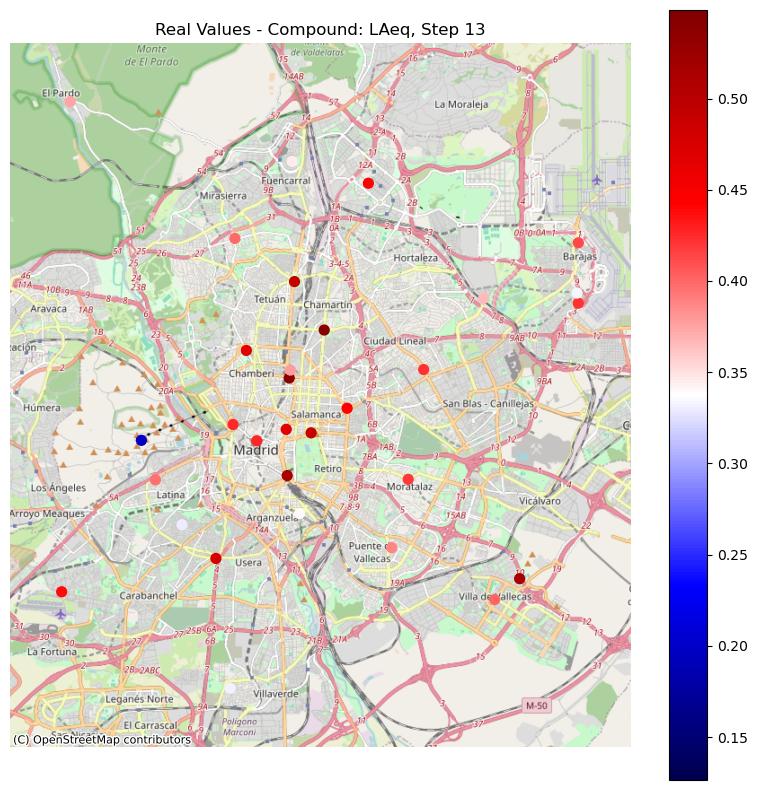

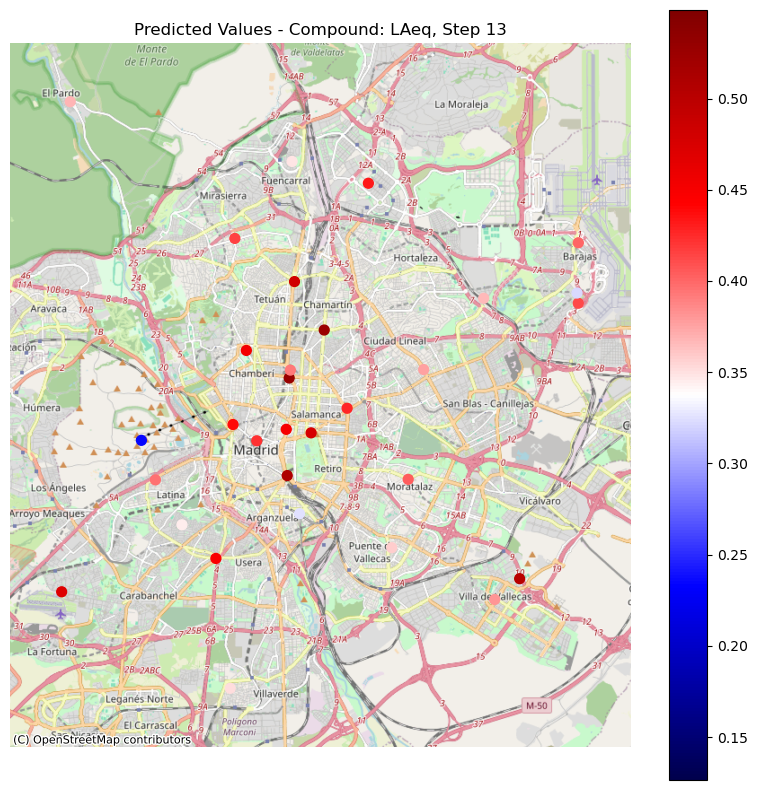

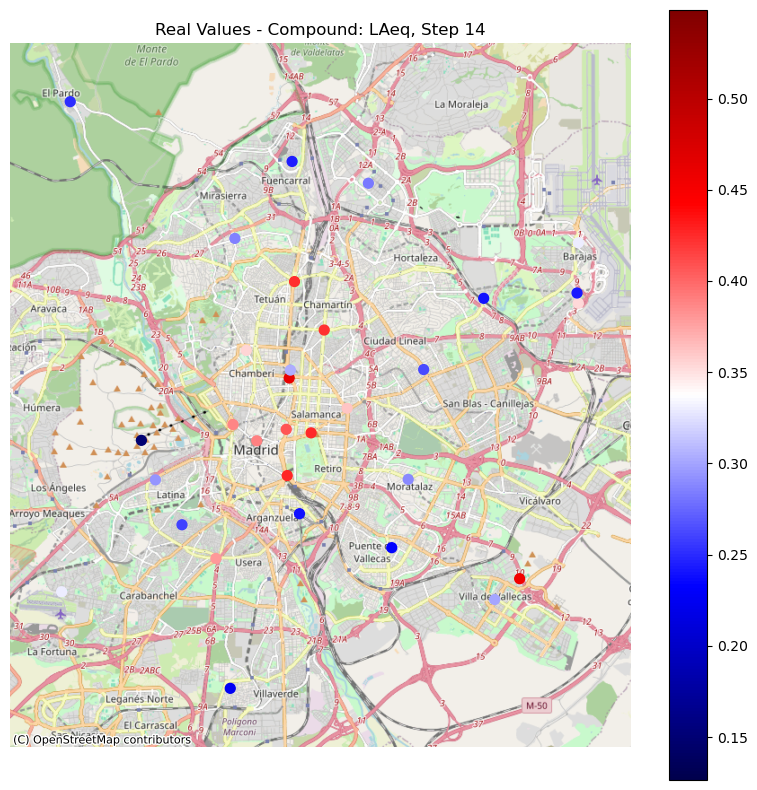

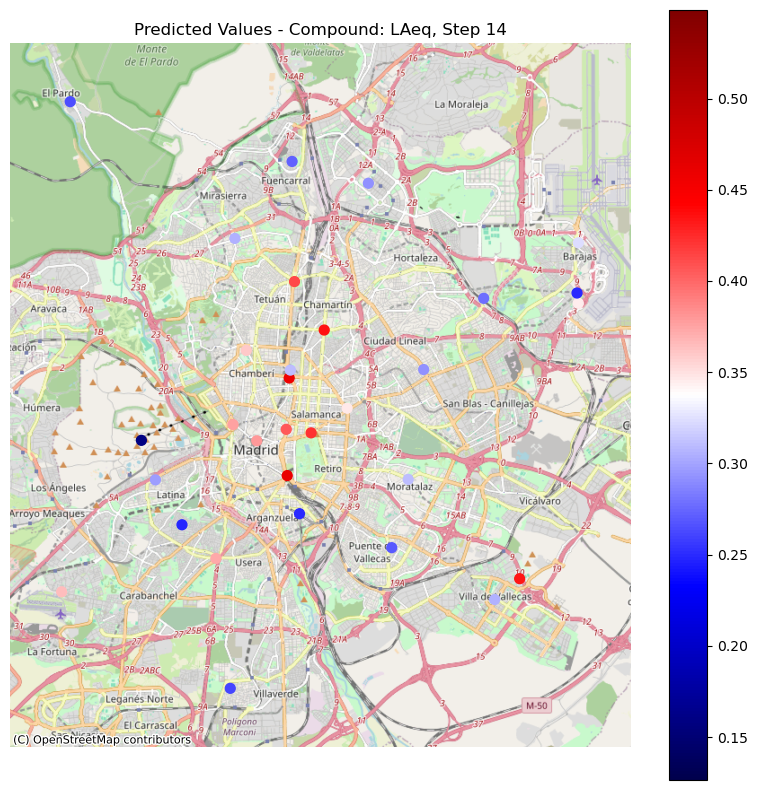

In [10]:
import torch
import matplotlib.pyplot as plt
import numpy as np
import geopandas as gpd
import contextily as ctx
from shapely.geometry import Point
import pandas as pd

# Function to collect outputs and targets from a single batch
def test_and_collect_single_batch(model, test_loader, num_compounds, num_steps):
    model.eval()
    device = next(model.parameters()).device

    with torch.no_grad():
        for data in test_loader:
            data = data.to(device)
            out = model(data.x, data.edge_index)
            y = data.y.view(-1, num_compounds, num_steps).to(device)
            
            # Ensure 'out' has the same shape as 'y'
            out = out.view(-1, num_compounds, num_steps).detach().cpu().numpy()
            y = y.detach().cpu().numpy()
            # Return the first batch of data
            return out, y

# Function to find the value limits for the color scale per compound
def find_value_limits_per_compound(outputs, targets, num_compounds, num_steps):
    vmin = np.full(num_compounds, float('inf'))
    vmax = np.full(num_compounds, float('-inf'))
    for j in range(num_compounds):
        for i in range(num_steps):
            vmin[j] = min(vmin[j], targets[:, j, i].min(), outputs[:, j, i].min())
            vmax[j] = max(vmax[j], targets[:, j, i].max(), outputs[:, j, i].max())
    return vmin, vmax

# Function to plot the real and predicted values on separate maps
def plot_real_vs_pred_on_map(snapshot_data, outputs, targets, compound_names, vmin, vmax):
    # Extract coordinates from snapshot_data
    coordinates = snapshot_data.coordinates.detach().cpu().numpy()
    lats = coordinates[:, 0]
    lons = coordinates[:, 1]
    
    # Create a DataFrame with your data
    data_df = pd.DataFrame({
        'lat': lats,
        'lon': lons
    })

    num_compounds = len(compound_names)
    num_steps = targets.shape[2]

    for j in range(num_compounds):
        for i in range(num_steps):
            # Ensure coordinates match the values
            if len(lats) != outputs.shape[0] or len(lons) != outputs.shape[0]:
                print(f"Coordinate dimensions do not match the values for compound {compound_names[j]} and step {i+1}")
                continue

            # Add real and predicted values to the DataFrame
            data_df['real_values'] = targets[:, j, i]
            data_df['pred_values'] = outputs[:, j, i]

            # Create a GeoDataFrame
            geometry = [Point(xy) for xy in zip(data_df['lon'], data_df['lat'])]
            gdf = gpd.GeoDataFrame(data_df, geometry=geometry)

            # Set the CRS to WGS84
            gdf.set_crs(epsg=4326, inplace=True)

            # Convert to Web Mercator CRS
            gdf = gdf.to_crs(epsg=3857)

            # Get the data bounds to center the map
            x_min, y_min, x_max, y_max = gdf.total_bounds

            # Expand the bounds for better visualization
            x_buffer = (x_max - x_min) * 0.1
            y_buffer = (y_max - y_min) * 0.1
            x_min -= x_buffer
            x_max += x_buffer
            y_min -= y_buffer
            y_max += y_buffer

            # If you want to specifically center the map on Madrid, use these bounds:
            # x_min, y_min = -420000, 4920000
            # x_max, y_max = -410000, 4930000

            # Plot real values
            fig, ax = plt.subplots(figsize=(10, 10))
            gdf.plot(ax=ax, column='real_values', cmap='seismic', markersize=50, legend=True, vmin=vmin[j], vmax=vmax[j])

            # Add the basemap
            ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

            # Set map limits
            ax.set_xlim(x_min, x_max)
            ax.set_ylim(y_min, y_max)

            # Hide axes
            ax.set_axis_off()
            plt.title(f'Real Values - Compound: {compound_names[j]}, Step {i+1}')
            plt.show()

            # Plot predicted values
            fig, ax = plt.subplots(figsize=(10, 10))
            gdf.plot(ax=ax, column='pred_values', cmap='seismic', markersize=50, legend=True, vmin=vmin[j], vmax=vmax[j])

            # Add the basemap
            ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

            # Set map limits
            ax.set_xlim(x_min, x_max)
            ax.set_ylim(y_min, y_max)

            # Hide axes
            ax.set_axis_off()
            plt.title(f'Predicted Values - Compound: {compound_names[j]}, Step {i+1}')
            plt.show()

# Example usage:

# Assuming you have a trained model 'model', a DataLoader 'test_loader',
# and you know the number of compounds 'num_compounds' and time steps 'num_steps'.
# You also have a list of compound names 'compound_names'.

# Path to the snapshot
snapshot_path = 'Snapshots/snapshot_4000.pt'  # Change this to the correct path

# Load the snapshot
snapshot_data = torch.load(snapshot_path)

# Get the model's outputs and targets
outputs, targets = test_and_collect_single_batch(model, test_loader, num_compounds, num_steps)

# Find the value limits for the color scale per compound
vmin, vmax = find_value_limits_per_compound(outputs, targets, num_compounds, num_steps)

# Call the function to plot the maps
plot_real_vs_pred_on_map(snapshot_data, outputs, targets, nombres_compuestos, vmin, vmax)
